# Feature Map Maximization Visualization

In [1]:
# import python modules
from math import ceil
import datetime
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from fastai.conv_learner import *
from torchvision import models
import PIL
import numpy as np

# import our own modules
from FilterVisualizer import *
from utils import *

In [2]:
# override existing FilterVisualizer class to extract cnn model
# (different extranction can be required for each model)
class FilterVisualizer_New(FilterVisualizer):
    def extract_cnn_model(self):
        # get model as of Sequential layers and make it freeze it's parameters (non-trainable)
        self.model = nn.Sequential(*list(self.selected_model(pretrained=True).children())[:-2]).eval()
        set_trainable(self.model, False)

In [3]:
# init filter visualizer
FV = FilterVisualizer_New(models.resnet34)
FV.extract_cnn_model()

# set visualizer params
FV.set_visualizer_params(upscaling_steps=12, image_size=56, grad_steps=20, lr=1e-1, weight_decay=1e-6)

In [4]:
# cnn structure
FV.model

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (conv2): Conv2d(64, 64, ker

## Outline
### - Test 1: Random filters
### - Test 2: n Most Activated Filters
### - Test 3: Occuluded Parts

# Test 1: Random filters

Here we visualize random feature map results for randomly selected filters computed on noise image for different layer elements.

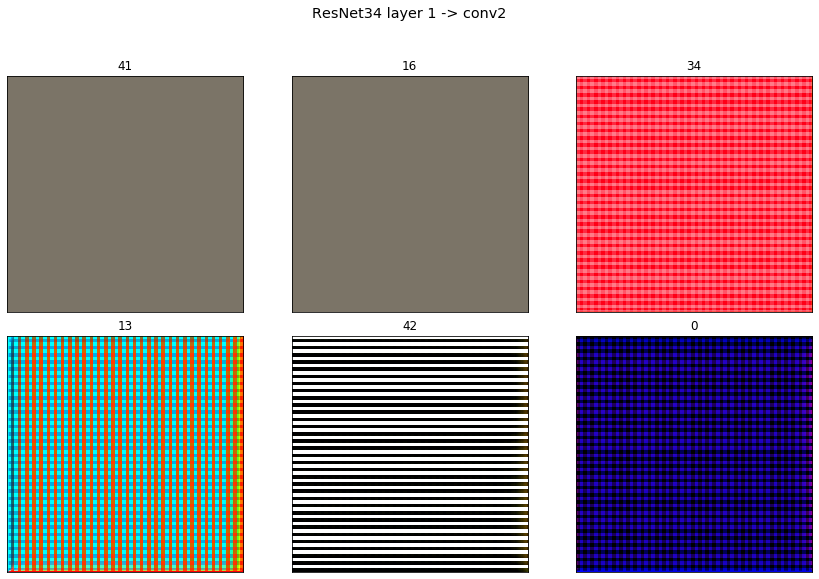

In [5]:
# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[0], [random.randint(0, 64) for i in range(6)])

# plot
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 1 -> conv2')

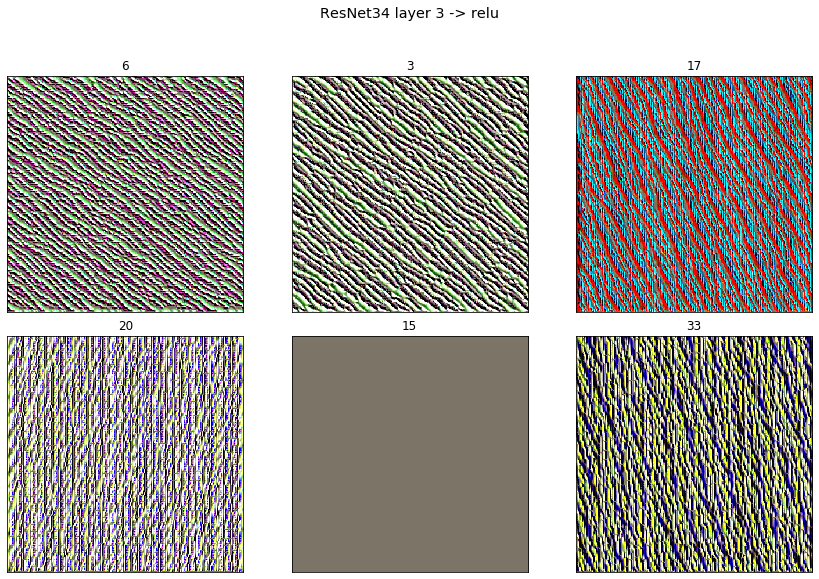

In [6]:
# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[3], [random.randint(0, 64) for i in range(6)])

# plot
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 3 -> relu')

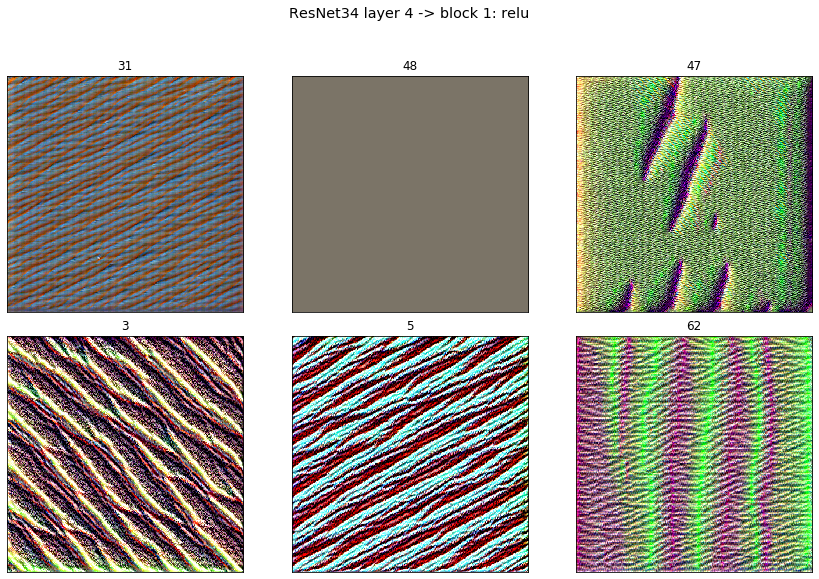

In [7]:
# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[4][0].relu, [random.randint(0, 64) for i in range(6)])

# plot
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 4 -> block 1: relu')

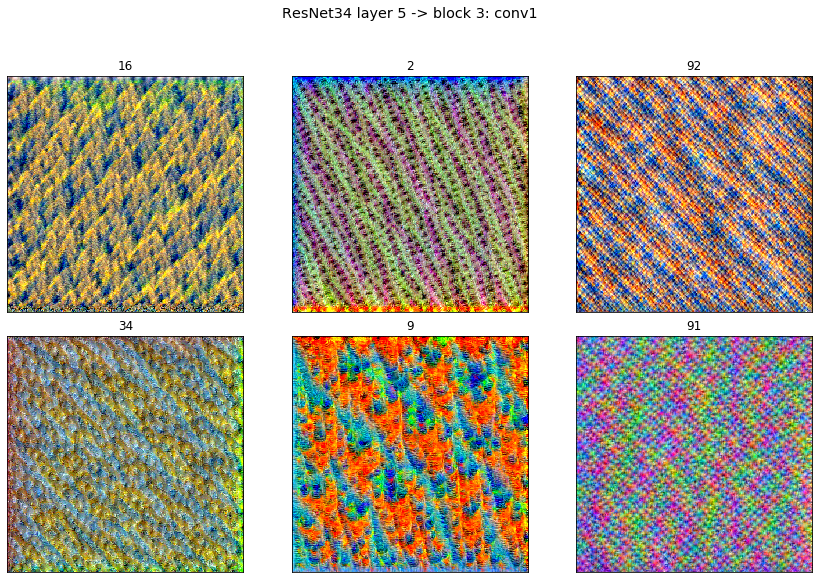

In [8]:
# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[5][1].conv1, [random.randint(0, 128) for i in range(6)])

# plot
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 5 -> block 3: conv1')

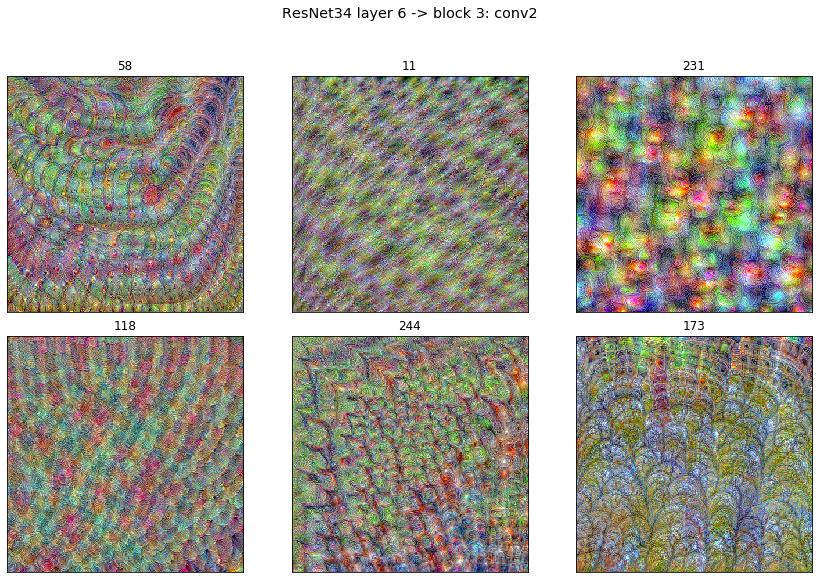

In [9]:
# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[6][2].conv2, [random.randint(0, 256) for i in range(6)])

# plot
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 6 -> block 3: conv2')

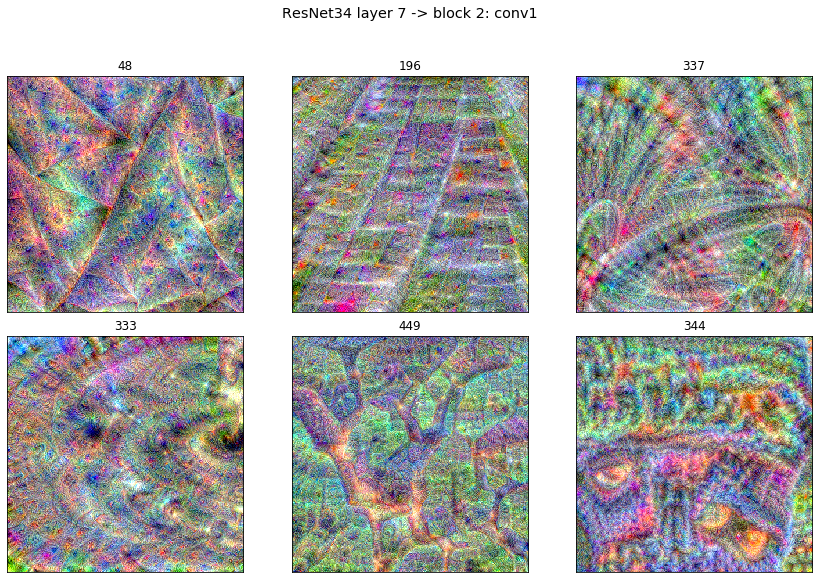

In [10]:
# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[7][1].conv1, [random.randint(0, 512) for i in range(6)])

# plot
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 7 -> block 2: conv1')

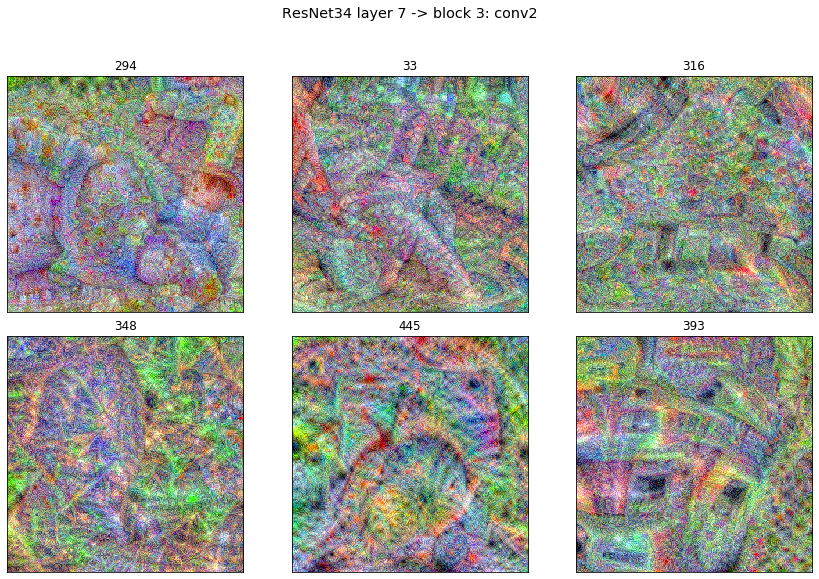

In [11]:
# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[7][2].conv2, [random.randint(0, 512) for i in range(6)])

# plot
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 7 -> block 3: conv2')

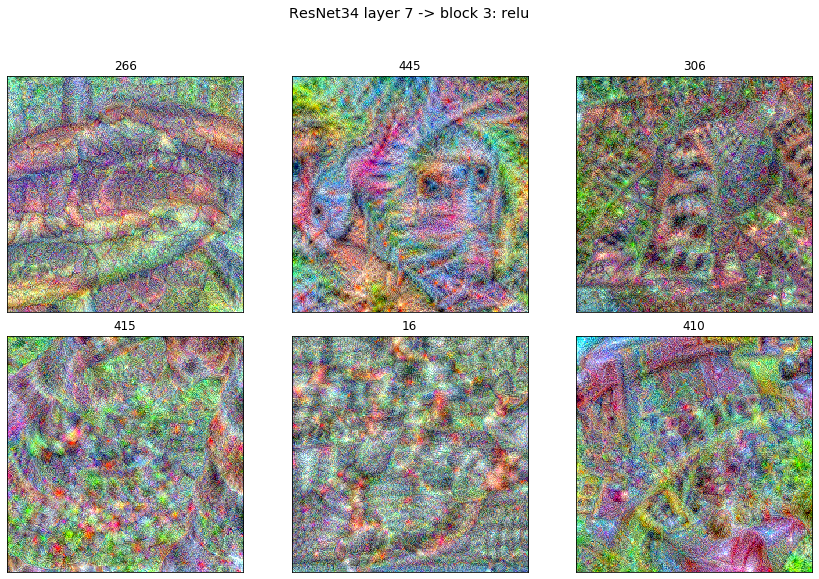

In [12]:
# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[7][2].relu, [random.randint(0, 512) for i in range(6)])

# plot
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 7 -> block 3: relu')

# Test 2: n Most Activated Filters

Here we visualize feature map results for filters that have the highest activation for the given image. The objective here is to show how the maximized feature map corresponds to the given image. All the examples are computed on relu of the second block in the last layer.

### Target Pic: old building

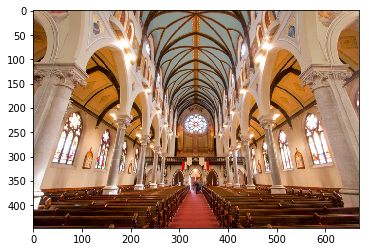

In [13]:
picture = np.array(PIL.Image.open('images/church.jpg'))
plt.imshow(picture)

2021-04-09 06:01:06.093067


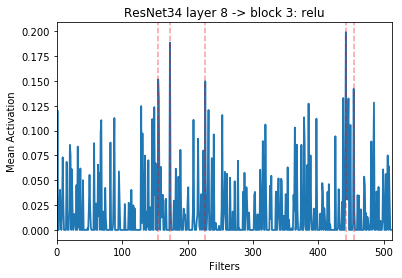

2021-04-09 06:20:04.891233


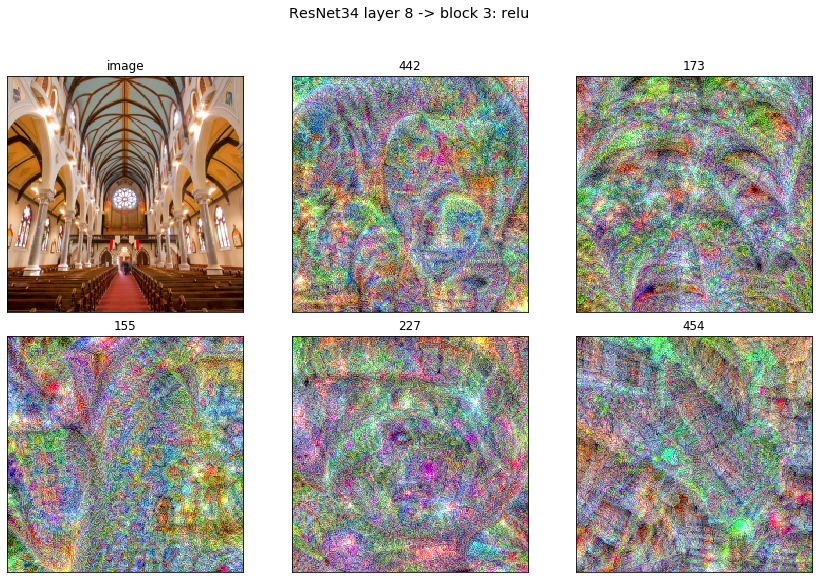

In [14]:
print(datetime.datetime.now())
# get n strogest activated filters
nstrongest_filters, mean_f = FV.get_nstrongest_filters(picture, FV.model[7][2].conv2, 5)

# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[7][2].conv2, nstrongest_filters)

# add the transformed image values to lists
fmaps.insert(0, FV.get_transformed_image(picture))
name_fmaps.insert(0, 'image')

# plot mean activation per filter
plot_mean_activations(nstrongest_filters, mean_f, figure_name='ResNet34 layer 8 -> block 3: relu')

# plot feature maps
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 8 -> block 3: relu')

print(datetime.datetime.now())

del fmaps
del name_fmaps
del nstrongest_filters

### Traget Pic: Johanner Markt

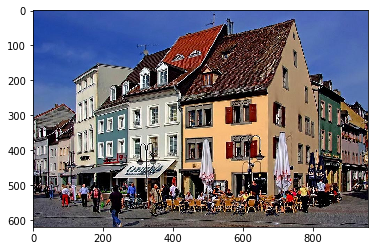

In [15]:
picture = np.array(PIL.Image.open('images/johannermarkt.jpg'))
plt.imshow(picture)

2021-04-09 06:20:08.158029
2021-04-09 06:39:09.159028


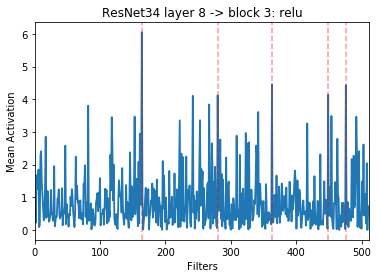

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


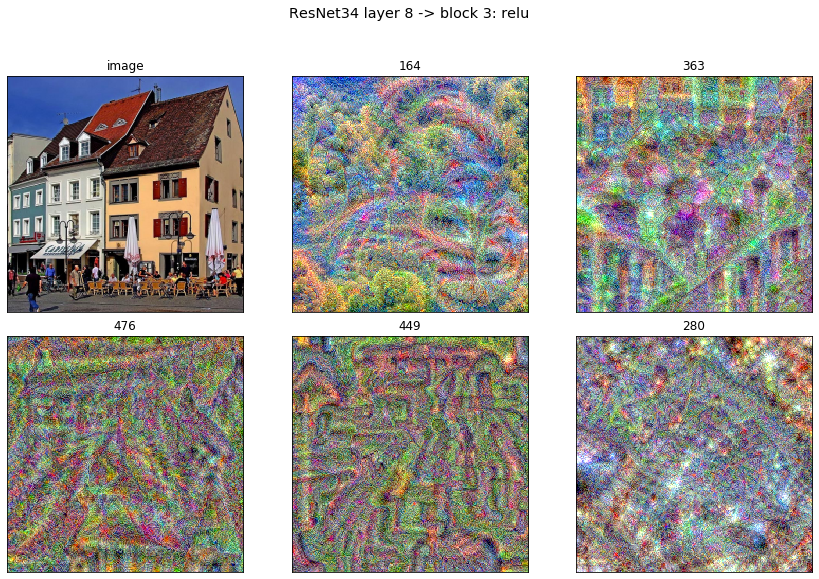

In [16]:
# get n strogest activated filters
nstrongest_filters, mean_f = FV.get_nstrongest_filters(picture, FV.model[7][2].relu, 5)

print(datetime.datetime.now())

# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[7][2].relu, nstrongest_filters)

print(datetime.datetime.now())

# add the transformed image values to lists
fmaps.insert(0, FV.get_transformed_image(picture))
name_fmaps.insert(0, 'image')

# plot mean activation per filter
plot_mean_activations(nstrongest_filters, mean_f, figure_name='ResNet34 layer 8 -> block 3: relu')

# plot feature maps
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 8 -> block 3: relu')

del fmaps
del name_fmaps
del nstrongest_filters

### Target Pic: tree

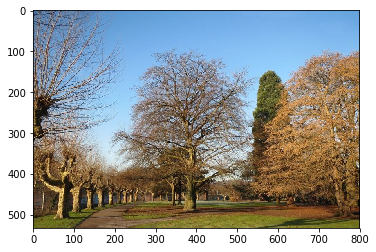

In [17]:
picture = np.array(PIL.Image.open('images/tree.jpg'))
plt.imshow(picture)

2021-04-09 06:39:13.138784
2021-04-09 06:58:04.864988


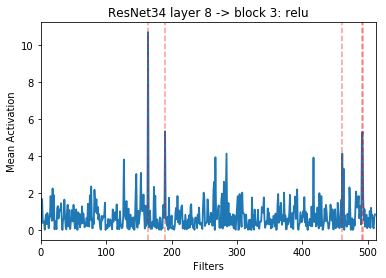

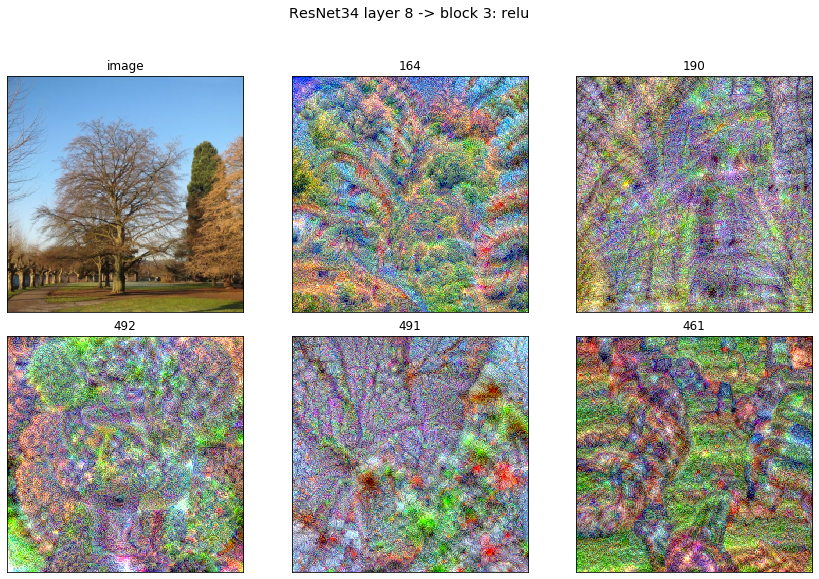

In [18]:
# get n strogest activated filters
nstrongest_filters, mean_f = FV.get_nstrongest_filters(picture, FV.model[7][2].relu, 5)

print(datetime.datetime.now())

# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[7][2].relu, nstrongest_filters)

print(datetime.datetime.now())

# add the transformed image values to lists
fmaps.insert(0, FV.get_transformed_image(picture))
name_fmaps.insert(0, 'image')

# plot mean activation per filter
plot_mean_activations(nstrongest_filters, mean_f, figure_name='ResNet34 layer 8 -> block 3: relu')

# plot feature maps
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 8 -> block 3: relu')

del fmaps
del name_fmaps
del nstrongest_filters

### Target Pic: Mogli (Dog)

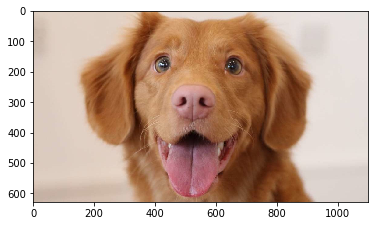

In [19]:
picture = np.array(PIL.Image.open('images/dog.jpg'))
plt.imshow(picture)

2021-04-09 06:58:08.482822
2021-04-09 07:17:04.197097


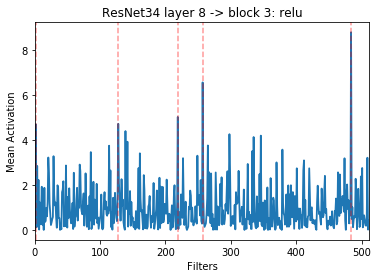

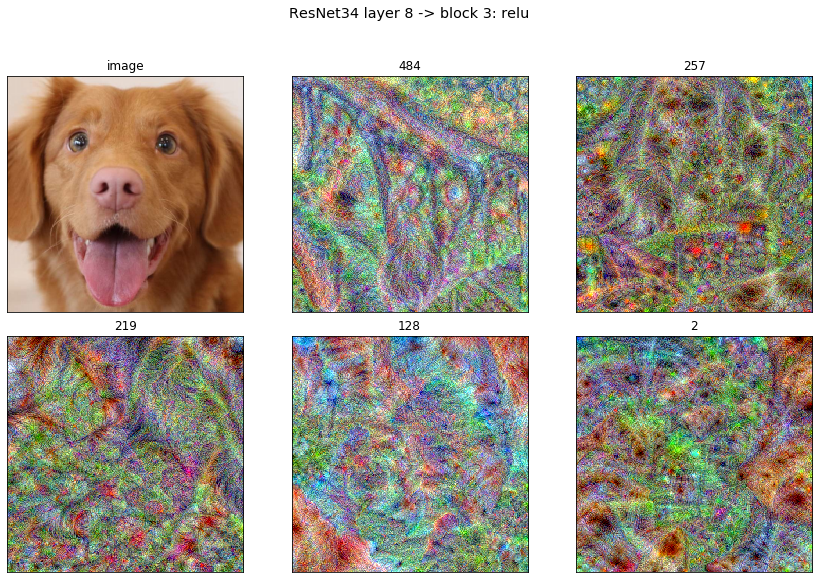

In [20]:
# get n strogest activated filters
nstrongest_filters, mean_f = FV.get_nstrongest_filters(picture, FV.model[7][2].relu, 5)

print(datetime.datetime.now())

# get the fmaps for selected filters
fmaps, name_fmaps = FV.generate_selected_fmaps(FV.model[7][2].relu, nstrongest_filters)

print(datetime.datetime.now())

# add the transformed image values to lists
fmaps.insert(0, FV.get_transformed_image(picture))
name_fmaps.insert(0, 'image')

# plot mean activation per filter
plot_mean_activations(nstrongest_filters, mean_f, figure_name='ResNet34 layer 8 -> block 3: relu')

# plot feature maps
plot_pics(fmaps, name_fmaps, n_cols=3, cell_size=4, figure_name='ResNet34 layer 8 -> block 3: relu')

del fmaps
del name_fmaps
del nstrongest_filters

# Test 3: Occuluded Parts

The goal here is to show how much important is the parts of picture is for filter activation.

In [21]:
pics = []
pics_name = ['dog.jpg', 'dog2.jpg', 'dog3.jpg', 'dog4.jpg', 'dog5.jpg', 'dog6.jpg', 'dog7.jpg', 'dog8.jpg', 'dog9.jpg']
for file_i in pics_name:
    tmp_pic = np.array(PIL.Image.open('images/'+file_i))
    pics.append(tmp_pic)

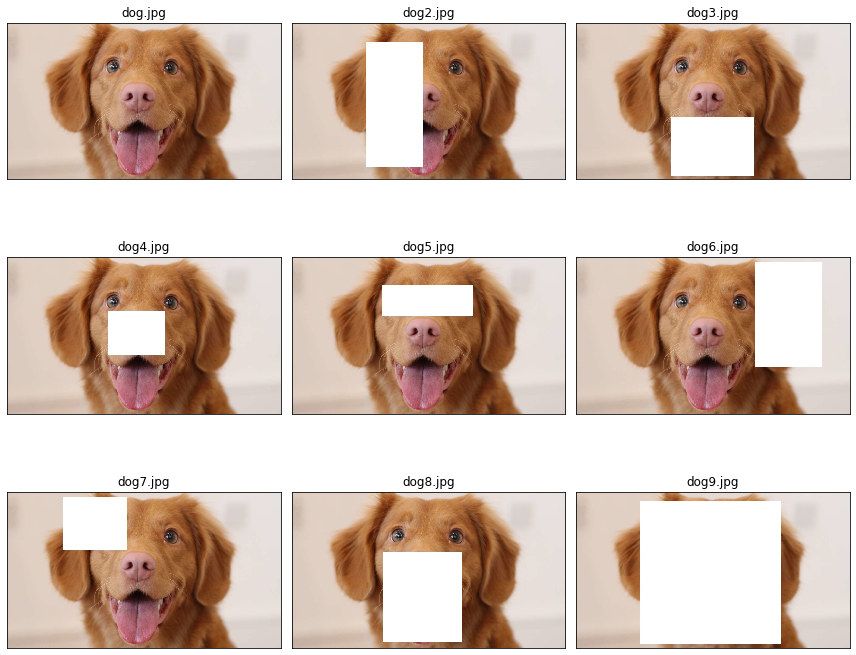

In [22]:
plot_pics(pics, pics_name, n_cols=3)

Show which ones are the n-strongest-activated filters for each picture. Doing it onthe relu activator of second block of the last layer in the cnn model.

In [23]:
n=10
# print the strongest filters for the unocculuded picture
original_nstrongest_filters, _ = FV.get_nstrongest_filters(pics[0], FV.model[7][2].relu, n)
print(f'{pics_name[0].upper()} {original_nstrongest_filters}')

# print the strongest filters for the occuluded picture, and show how many of them are in common with the original pic
for pic, name in zip(pics[1:], pics_name[1:]):
    # get n strogest activated filters
    nstrongest_filters, _ = FV.get_nstrongest_filters(pic, FV.model[7][2].relu, n)

    # find the number of common filters
    n_comon = len(list(set(original_nstrongest_filters).intersection(nstrongest_filters)))
    print(f'{name.upper()}  filter: {nstrongest_filters} - {n_comon}/{n} common')

DOG.JPG [484, 257, 219, 128, 2, 139, 298, 346, 335, 142]
DOG2.JPG  filter: [128, 257, 484, 219, 114, 420, 2, 139, 142, 361] - 7/10 common
DOG3.JPG  filter: [484, 139, 257, 219, 128, 2, 335, 114, 142, 265] - 8/10 common
DOG4.JPG  filter: [484, 257, 128, 219, 249, 335, 298, 86, 114, 464] - 6/10 common
DOG5.JPG  filter: [484, 257, 128, 219, 139, 114, 265, 464, 142, 2] - 7/10 common
DOG6.JPG  filter: [128, 257, 2, 484, 139, 335, 114, 219, 379, 142] - 8/10 common
DOG7.JPG  filter: [484, 257, 114, 2, 128, 139, 219, 335, 142, 265] - 8/10 common
DOG8.JPG  filter: [484, 219, 128, 257, 114, 335, 298, 474, 29, 412] - 6/10 common
DOG9.JPG  filter: [153, 420, 352, 92, 361, 88, 270, 20, 148, 114] - 0/10 common
